In [84]:
import scanpy as sc
import numpy as np
import pandas as pd

In [7]:
rest_data = sc.read("processed_files/nearest_neighbours.h5ad")

In [85]:
# Create pseudobulks for whole dataset
donors = list(rest_data.obs["donor_id"].value_counts().index)

for  d in donors:
    donor_data = rest_data[rest_data.obs["donor_id"] == d]

    donor_obs = donor_data.obs.mode(axis=0).iloc[0]
    donor_obs_df = pd.DataFrame([donor_obs])
    donor_obs_df.index = [d]

    donor_x = donor_data.raw.X.mean(axis=0)
    X_df = donor_x[0]
    X_df.index = [d]

    donor_vars = donor_data.var

    donor_object = sc.AnnData(donor_x, obs=donor_obs_df, var=donor_vars)
    donor_object.write(f"processed_files/donor_pseudobulk/donor_{d}.h5ad")

/Users/shaunak/PycharmProjects/Single_Cell_Alzheimers/.venv/lib/python3.13/site-packages/anndata/_core/anndata.py:242: ImplicitModificationWarning: X should not be a np.matrix, use np.ndarray instead.
  self._init_as_actual(
/Users/shaunak/PycharmProjects/Single_Cell_Alzheimers/.venv/lib/python3.13/site-packages/anndata/_core/anndata.py:242: ImplicitModificationWarning: X should not be a np.matrix, use np.ndarray instead.
  self._init_as_actual(
/Users/shaunak/PycharmProjects/Single_Cell_Alzheimers/.venv/lib/python3.13/site-packages/anndata/_core/anndata.py:242: ImplicitModificationWarning: X should not be a np.matrix, use np.ndarray instead.
  self._init_as_actual(
/Users/shaunak/PycharmProjects/Single_Cell_Alzheimers/.venv/lib/python3.13/site-packages/anndata/_core/anndata.py:242: ImplicitModificationWarning: X should not be a np.matrix, use np.ndarray instead.
  self._init_as_actual(
/Users/shaunak/PycharmProjects/Single_Cell_Alzheimers/.venv/lib/python3.13/site-packages/anndata/_co

In [117]:
# create a pseudobulk from the selected cluster
selected_cluster = sc.read("processed_files/significant_subpopulation/cluster2424.h5ad")

donors = list(selected_cluster.obs["donor_id"].value_counts().index)

for d in donors:
    donor_data = selected_cluster[selected_cluster.obs["donor_id"] == d]

    donor_obs = donor_data.obs.mode(axis=0).iloc[0]
    donor_obs_df = pd.DataFrame([donor_obs])
    donor_obs_df.index = ["cluster" + d]

    donor_x = donor_data.raw.X.mean(axis=0)
    X_df = donor_x[0]
    X_df.index = ["cluster" + d]

    donor_vars = donor_data.var

    donor_object = sc.AnnData(donor_x, obs=donor_obs_df, var=donor_vars)
    donor_object.write(f"processed_files/donor_pseudobulk/cluster_{d}.h5ad")

/Users/shaunak/PycharmProjects/Single_Cell_Alzheimers/.venv/lib/python3.13/site-packages/anndata/_core/anndata.py:242: ImplicitModificationWarning: X should not be a np.matrix, use np.ndarray instead.
  self._init_as_actual(
/Users/shaunak/PycharmProjects/Single_Cell_Alzheimers/.venv/lib/python3.13/site-packages/anndata/_core/anndata.py:242: ImplicitModificationWarning: X should not be a np.matrix, use np.ndarray instead.
  self._init_as_actual(
/Users/shaunak/PycharmProjects/Single_Cell_Alzheimers/.venv/lib/python3.13/site-packages/anndata/_core/anndata.py:242: ImplicitModificationWarning: X should not be a np.matrix, use np.ndarray instead.
  self._init_as_actual(
/Users/shaunak/PycharmProjects/Single_Cell_Alzheimers/.venv/lib/python3.13/site-packages/anndata/_core/anndata.py:242: ImplicitModificationWarning: X should not be a np.matrix, use np.ndarray instead.
  self._init_as_actual(
/Users/shaunak/PycharmProjects/Single_Cell_Alzheimers/.venv/lib/python3.13/site-packages/anndata/_co

In [118]:
# gather all the pseudobulk files
import os

directory = "processed_files/donor_pseudobulk"
files = os.listdir(directory)  # lists everything: files + folders

original_pseudobulk = sc.read(f"{directory}/{files[0]}")

pseudobulk = original_pseudobulk
for f in files[1:]:
    path = f"{directory}/{f}"
    donor_sample = sc.read(path)
    pseudobulk = sc.concat([pseudobulk, donor_sample], join='outer')

pseudobulk.var = original_pseudobulk.var

In [121]:
# add selected column
n = pseudobulk.shape[0]
pseudobulk.obs["category"] = pd.Categorical(["als"] * n).set_categories(["als", "normal", "cluster"])
pseudobulk.obs.loc[pseudobulk.obs[pseudobulk.obs["disease"] != "Alzheimer_disease"].index, "category"] = "normal"

In [127]:
clusters = [f for f in pseudobulk.obs.index if f.startswith("cluster")]
pseudobulk.obs.loc[clusters, "category"] = "cluster"

In [164]:
pseudobulk.obs

,APOE_class,Brain.Region,SORT,Braak.stage,Disease.Group,Amyloid,Brain.weight,PMI.hr.,Race,Age,...,sex,tissue,self_reported_ethnicity,development_stage,observation_joinid,nhood_ixs_random,nhood_ixs_refined,nhood_kth_distance,selected,category
92,E3/E4,Frontal Cx (BA9),All Nuclei,IV,int,C1,1180.0,5.0,nan,89,...,female,Brodmann (1909) area 9,unknown,89-year-old stage,!#?DInC{~k,0.0,0.0,0.0,1.0,als
30,E3/E4,Frontal Cx (BA9),NeuN,III,int,DP (C0),nan,10.0,nan,81,...,female,Brodmann (1909) area 9,unknown,81-year-old stage,!!i{2iUz%?,0.0,0.0,0.0,1.0,als
114,E3/E4,Frontal Cx (BA9),NeuN,IV,int,DP (C0),nan,24.1,black,66,...,female,Brodmann (1909) area 9,African American,66-year-old stage,!!I&P6&)2l,0.0,0.0,0.0,1.0,als
71,E3/E3,Precuneous (BA7),NeuN,0,low,No,1400.0,24.0,hispanic,52,...,male,Brodmann (1909) area 7,Hispanic or Latin American,52-year-old stage,!&A=H*RL^~,0.0,0.0,0.0,normal,normal
cluster103,E3/E3,Precuneous (BA7),NeuN,0,low,No,1160.0,33.0,nan,67,...,female,Brodmann (1909) area 7,unknown,67-year-old stage,9f)(0n?_hF,0.0,0.0,0.0,normal,cluster
115,E3/E3,Frontal Cx (BA9),NeuN,0,low,No,nan,24.9,hispanic,71,...,male,Brodmann (1909) area 9,Hispanic or Latin American,71-year-old stage,!!?g(rl7cU,0.0,0.0,0.0,normal,normal
103,E3/E3,Frontal Cx (BA9),NeuN,0,low,No,1160.0,33.0,nan,67,...,female,Brodmann (1909) area 9,unknown,67-year-old stage,!&LiNghj@n,0.0,0.0,0.0,normal,normal
123,nan,Frontal Cx (BA9),NeuN,I,low,No,nan,10.4,white,66,...,female,Brodmann (1909) area 9,European,66-year-old stage,!E%9aii~0j,0.0,0.0,0.0,normal,normal
46,E3/E3,Primary Visual Cx (BA17),NeuN,IV,int,C1,1375.0,19.5,nan,83,...,male,Brodmann (1909) area 17,unknown,83-year-old stage,!!ef?SRik),0.0,0.0,0.0,1.0,als
50,E3/E3,Frontal Cx (BA9),NeuN,II,low,No,1480.0,19.5,nan,61,...,male,Brodmann (1909) area 9,unknown,61-year-old stage,!!2GHYEEq^,0.0,0.0,0.0,normal,normal


In [ ]:
import pandas as pd
import rpy2.robjects as ro
from rpy2.robjects import pandas2ri
from rpy2.robjects.conversion import localconverter
from rpy2.robjects.packages import importr

# Import DESeq2
try:
    deseq2 = importr('DESeq2')
except Exception as e:
    print("DESeq2 is not installed. Please install via BiocManager in R.")
    raise e

# Prepare counts and metadata
r_meta = pseudobulk.obs.copy()
for col in ['donor_id', 'category']:
    r_meta[col] = r_meta[col].astype('category')

# Convert data to R objects using localconverter (avoids activate/deactivate)
with localconverter(ro.default_converter + pandas2ri.converter):
    r_counts = pd.DataFrame(
        pseudobulk.X.T.astype(int),
        index=pseudobulk.var_names,
        columns=pseudobulk.obs_names
    )
    r_colData = r_meta

# Assign to R environment
    ro.globalenv['countData'] = r_counts
    ro.globalenv['colData'] = r_colData

# Run DESeq2
ro.r('''
dds <- DESeqDataSetFromMatrix(
    countData = countData,
    colData = colData,
    design = ~ donor_id + category
)
dds <- DESeq(dds)
res <- results(dds, contrast = c("condition", "cluster", "als"))
''')

# Convert results back to pandas
with localconverter(ro.default_converter + pandas2ri.converter):
    res_df = pd.DataFrame(ro.r('as.data.frame(res)'))

# Optional: inspect results
print(res_df.head())

/Users/shaunak/PycharmProjects/Single_Cell_Alzheimers/.venv/lib/python3.13/site-packages/rpy2/robjects/pandas2ri.py:65: UserWarning: Error while trying to convert the column "selected". Fall back to string conversion. The error is: Series can only be of one type, or None (and here we have <class 'float'> and <class 'str'>). If happening with a pandas DataFrame the method infer_objects() will normalize data types before conversion.
  warnings.warn('Error while trying to convert '
R callback write-console: estimating size factors
  
R callback write-console: estimating dispersions
  
R callback write-console: gene-wise dispersion estimates
  


In [ ]:

sc.tl.rank_genes_groups(pseudobulk, groupby="cluster", use_raw=False, method="logreg")

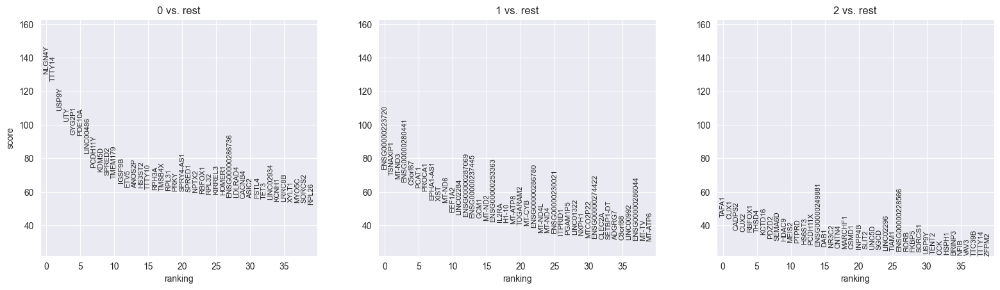

In [107]:
sc.pl.rank_genes_groups(rest_data, groupby="selected",  gene_symbols="feature_name", n_genes=40, figsize=(15, 15))

In [123]:
marker_genes = sc.get.rank_genes_groups_df(rest_data, group="2")
significant_genes = marker_genes[marker_genes['pvals_adj'] < 0.05]
sorted_genes = significant_genes.sort_values(by='scores', ascending=False)

In [75]:
marker_genes = sc.get.rank_genes_groups_df(rest_data, group="2")
sorted_genes = marker_genes

In [124]:
sorted_genes

,names,scores,logfoldchanges,pvals,pvals_adj
4949,ENSG00000253474,-37.791515,-21.965563,0.0,0.0
4951,ENSG00000159307,-38.433018,-22.298616,0.0,0.0
4952,ENSG00000289195,-38.538605,-21.988329,0.0,0.0
4953,ENSG00000273409,-38.589996,-22.011831,0.0,0.0
4954,ENSG00000226846,-38.942646,-22.963116,0.0,0.0
4955,ENSG00000285712,-39.252388,-21.966013,0.0,0.0
4956,ENSG00000224982,-39.286270,-22.063841,0.0,0.0
4957,ENSG00000106366,-39.460556,-22.183891,0.0,0.0
4958,ENSG00000183853,-39.891735,-22.211685,0.0,0.0
4959,ENSG00000133105,-39.920986,-22.360130,0.0,0.0


In [125]:
changed_names = [rest_data.var["feature_name"][i] for i in sorted_genes["names"]]

In [87]:
sorted_genes["names"] = changed_names

In [126]:
gene_list = changed_names[:500]
gene_list

['ENSG00000253474',
 'SCUBE1',
 'ENSG00000289195',
 'LINC02712',
 'LINC00348',
 'ENSG00000285712',
 'TMEM233',
 'SERPINE1',
 'KIRREL1',
 'RXFP2',
 'LINC01550',
 'ENSG00000241168',
 'CD24',
 'DLX6-AS1',
 'ANXA3',
 'ENSG00000286889',
 'OR52A5',
 'SCTR',
 'LRAT',
 'OR3A3',
 'CAPN8',
 'ENSG00000286082',
 'DAPL1',
 'ENSG00000248145',
 'ENSG00000264634',
 'LINC01164',
 'ALPL',
 'MTCO1P40',
 'LINC01443',
 'CACNG4',
 'POSTN',
 'LINC02691',
 'ENSG00000286470',
 'NPAS4',
 'FOLH1B',
 'TWIST2',
 'OLFML2B',
 'ENSG00000264869',
 'ENSG00000285718',
 'LINC02082',
 'ENSG00000286046',
 'GJD2-DT',
 'ENSG00000279249',
 'ENSG00000286474',
 'ENSG00000286647',
 'CCDC68',
 'ENSG00000237445',
 'LINC00343']

In [128]:
import gseapy as gp
gene_sets = [
    'GO_Biological_Process_2021',
    'KEGG_2021_Human',
    'Reactome_2022',
    'MSigDB_Hallmark_2020',
    'WikiPathways_2021_Human'
]

enr = gp.prerank(rnk= sorted_genes,
                 gene_sets=gene_sets,   # or 'GO_Biological_Process_2021'
                 organism='Human',                # 'Mouse' also works
                 outdir='enrichr_kegg',
                 cutoff=0.05,
                 format="png"
                )  # FDR cutoff


TypeError: stat: path should be string, bytes, os.PathLike or integer, not list

In [95]:
enr.results

{'GO_Biological_Process_2021__positive regulation of apoptotic signaling pathway (GO:2001235)': {'name': 'prerank',
  'es': -0.3432567178070425,
  'nes': -0.7970035649760567,
  'pval': 0.7206703910614525,
  'fdr': 1.0,
  'fwerp': 1.0,
  'tag %': '5/15',
  'gene %': '16.90%',
  'lead_genes': 'GSDME;TGFBR1;CYLD;TPD52L1;RACK1',
  'matched_genes': 'BCAP31;FIS1;CRADD;BID;STYXL1;RPS3;S100A8;PMAIP1;RIPK1;CAV1;RACK1;TPD52L1;CYLD;TGFBR1;GSDME',
  'hits': [209,
   495,
   515,
   792,
   1565,
   1790,
   2243,
   2278,
   3119,
   3545,
   4156,
   4216,
   4605,
   4631,
   4682],
  'RES': [-0.00020060180541624874,
   -0.00040120361083249747,
   -0.0006018054162487462,
   -0.0008024072216649949,
   -0.0010030090270812437,
   -0.0012036108324974925,
   -0.0014042126379137413,
   -0.00160481444332999,
   -0.001805416248746239,
   -0.0020060180541624875,
   -0.0022066198595787363,
   -0.002407221664994985,
   -0.002607823470411234,
   -0.0028084252758274826,
   -0.0030090270812437314,
   -0.00320